In [ ]:
%pip install folium --upgrade

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from datetime import datetime
from datetime import date
import folium
from folium import plugins

On charge le dataset Uber Pickups du mois de mai 2014

In [ ]:
data = pd.read_csv("https://raw.githubusercontent.com/fivethirtyeight/uber-tlc-foil-response/master/uber-trip-data/uber-raw-data-may14.csv")
data

,Date/Time,Lat,Lon,Base
0,5/1/2014 0:02:00,40.7521,-73.9914,B02512
1,5/1/2014 0:06:00,40.6965,-73.9715,B02512
2,5/1/2014 0:15:00,40.7464,-73.9838,B02512
3,5/1/2014 0:17:00,40.7463,-74.0011,B02512
4,5/1/2014 0:17:00,40.7594,-73.9734,B02512
...,...,...,...,...
652430,5/31/2014 23:45:00,40.7309,-74.0014,B02764
652431,5/31/2014 23:52:00,40.7528,-73.9798,B02764
652432,5/31/2014 23:55:00,40.7158,-73.9519,B02764
652433,5/31/2014 23:56:00,40.6961,-73.8997,B02764


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 652435 entries, 0 to 652434
Data columns (total 4 columns):
Date/Time    652435 non-null object
Lat          652435 non-null float64
Lon          652435 non-null float64
Base         652435 non-null object
dtypes: float64(2), object(2)
memory usage: 19.9+ MB


# **Data preprocessing**

Premièrement, on crée les colonnes *Date*, *Weekday* et *Time* à partir de la colonne *Date/Time* existante.

In [ ]:
data['Date/Time'] = pd.to_datetime(data['Date/Time'])

data['Date'] = data['Date/Time'].apply(lambda x: datetime.date(x))
data['Weekday'] = data['Date'].apply(lambda x: date.isoweekday(x))
data['Time'] = data['Date/Time'].apply(lambda x: datetime.time(x))

data = data.drop(columns="Date/Time")

data.head()

,Lat,Lon,Base,Date,Weekday,Time
0,40.7521,-73.9914,B02512,2014-05-01,4,00:02:00
1,40.6965,-73.9715,B02512,2014-05-01,4,00:06:00
2,40.7464,-73.9838,B02512,2014-05-01,4,00:15:00
3,40.7463,-74.0011,B02512,2014-05-01,4,00:17:00
4,40.7594,-73.9734,B02512,2014-05-01,4,00:17:00


On crée également une colonne *Hour* à partir de la colonne *Time* puis on se débarasse des colonnes *Date*, *Time* et *Base*.

In [ ]:
data['Hour'] = data['Time'].apply(lambda x: x.hour)

data = data.drop(columns=["Date", "Time", "Base"])
data.head()

,Lat,Lon,Weekday,Hour
0,40.7521,-73.9914,4,0
1,40.6965,-73.9715,4,0
2,40.7464,-73.9838,4,0
3,40.7463,-74.0011,4,0
4,40.7594,-73.9734,4,0


# **Find KMeans Number Clusters**

On souhaite entraîner un modèle non-supervisé de KMeans. Pour cela, nous devons tout d'abord trouver le nombre de cluster optimum avec lequel l'algorithme séparera le dataset.

On commence par réaliser **une méthode Elbow**. On observe sur cette courbe que le nombre de **cluster optimium est de 3**. Cependant, cette méthode **n'est pas très fiable**. On va donc utiliser **la méthode des silhouettes** pour détermeiner ce nombre.

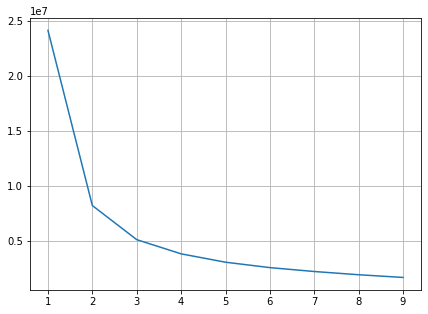

In [ ]:
from sklearn.cluster import KMeans

model = KMeans()

distortions = []
for k in range(1, 10):
    model = KMeans(n_clusters=k)
    model.fit(data)
    distortions.append(model.inertia_)

fig = plt.figure(figsize=(7, 5))
plt.plot(range(1, 10), distortions)
plt.grid(True) 
plt.show()

On réalise la **méthode des silhouettes** sur un **nombre de cluster compris entre 2 et 5**.

On observe que : 
- Pour un découpage en 2 et 3 clusters, une classe reste fortement sur-représentée.
- Pour un découpage en 5 clusters, deux classes sont sous-représentées.

D'après cette méthode, le **nombre de cluster optimum semble donc être de 4**.

For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.56376469026194


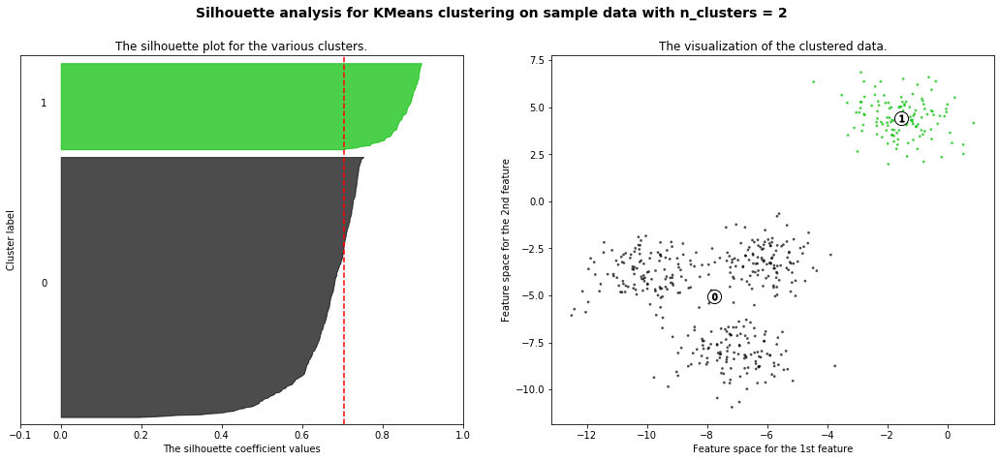

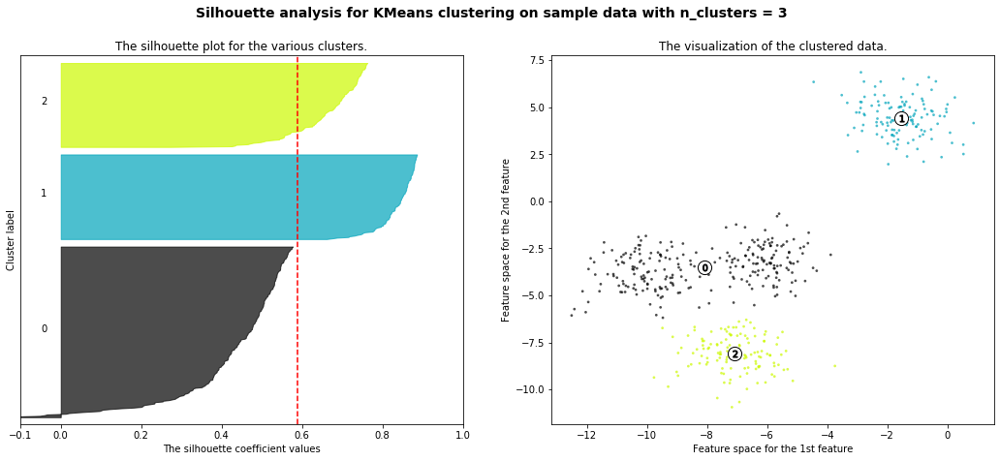

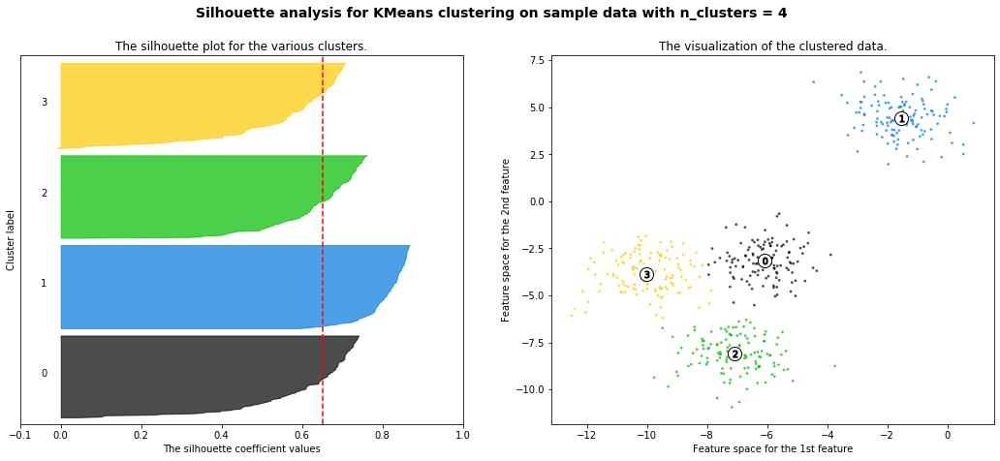

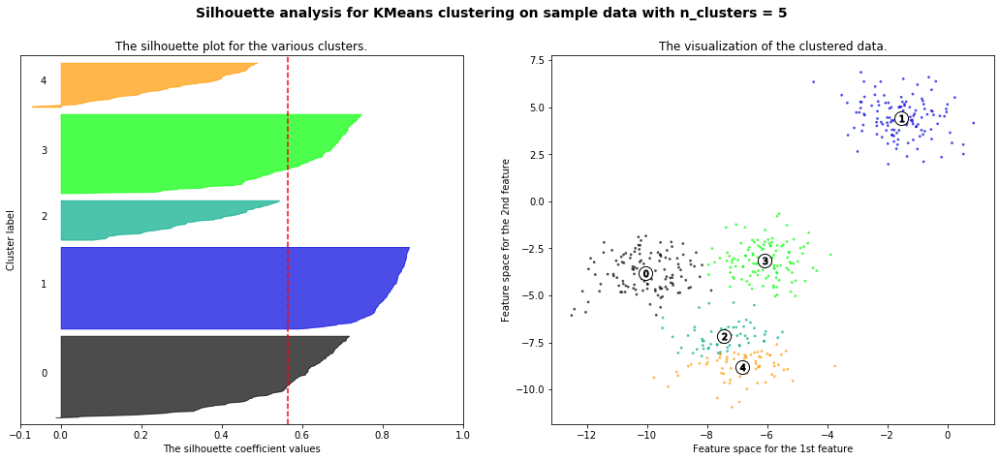

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.datasets import make_blobs

X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  cluster_std=1,
                  center_box=(-10.0, 10.0),
                  shuffle=True,
                  random_state=1)  # For reproducibility

range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

# **Data visualization on maps**

Maintenant que l'on a déterminé le nombre de clusters de notre algorithme KMeans, on va visualiser les données de notre dataset sur une carte à l'aide  de la librairie Folium.

On commence donc par créer une carte centrée sur la ville de New-York.

In [ ]:
map1 = folium.Map(location=[40.779897, -73.968565],
               zoom_start=11)

plugins.Fullscreen().add_to(map1)
plugins.ScrollZoomToggler().add_to(map1)

On ajoute à *map1* différents types de cartes qui permettront de la visualiser de différentes manières.

In [ ]:
#Show map types using layer control
folium.raster_layers.TileLayer('Open Street Map').add_to(map1)
folium.raster_layers.TileLayer('Stamen Terrain').add_to(map1)
folium.raster_layers.TileLayer('Stamen Toner').add_to(map1)
folium.raster_layers.TileLayer('Stamen Watercolor').add_to(map1)
folium.raster_layers.TileLayer('CartoDB Positron').add_to(map1)
folium.raster_layers.TileLayer('CartoDB Dark_Matter').add_to(map1)

#Add layer control to show different map types
folium.LayerControl().add_to(map1)

On supprime les colonnes *Hour* et *Weekday* pour pouvoir entraîner notre modèle uniquement sur les données géographiques.

In [ ]:
data_coord = data.drop(columns=['Hour', 'Weekday'])
data_coord.head()

,Lat,Lon
0,40.7521,-73.9914
1,40.6965,-73.9715
2,40.7464,-73.9838
3,40.7463,-74.0011
4,40.7594,-73.9734


On entraîne notre modèle sur ce nouveau dataset

In [ ]:
model = KMeans(n_clusters=4)

model.fit(data_coord)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

On regarde les coordonnées de nos **centres de clusters**

In [ ]:
centers = model.cluster_centers_

centers

array([[ 40.72292994, -73.99150573],
       [ 40.76861675, -73.96478155],
       [ 40.68065182, -73.77562989],
       [ 40.6960584 , -74.20266871]])

On ajoute ces centres de clusters à un dictionnaire. Puis, on itère sur ce dictionnaire afin de les placer sous forme de marqueur sur la carte *map1*. 

In [ ]:
dict_cluster = {}
count = 1

for center in centers:
    name = str('Cluster ' + str(count))
    dict_cluster[name] = list(center)
    count += 1

dict_cluster

{'Cluster 1': [40.722929935048036, -73.99150573336878],
 'Cluster 2': [40.76861675349379, -73.96478155272847],
 'Cluster 3': [40.680651824721465, -73.77562988858672],
 'Cluster 4': [40.69605840049597, -74.20266870737755]}

In [ ]:
for item in dict_cluster.items():
    folium.Marker(location=item[1], popup=item[0], icon=folium.Icon(icon='car', prefix='fa', color='red')).add_to(map1)

On visualise nos centres de clusters sur la carte. 

On remarque que : 
- 2 centres de clusters se trouvent à Manhattan
- 1 centre de cluster se trouve dans le quartier du Queens, près de l'aéroport J.F. Kennedy
- 1 centre de cluster se trouve à l'ouest, près de l'aéroport de Newark-Liberty


In [ ]:
map1

On va maintenant placer les points, repésentant l'endroit oû les personnes ont été prises en charge par leur chauffeur Uber sur une carte. 

Notre dataset étant très important (plus de 650 000 lignes), on utilise la méthode *sample* de Pandas pour créer un échantillon de notre dataset (7%).  

In [ ]:
data_sample = data_coord.sample(frac=0.07, axis=0).reset_index().drop(columns='index')

data_sample

,Lat,Lon
0,40.7292,-73.9796
1,40.7091,-74.0106
2,40.7718,-73.9536
3,40.7526,-73.9968
4,40.7337,-73.9961
...,...,...
45665,40.7370,-73.9741
45666,40.7106,-73.9663
45667,40.7224,-73.9918
45668,40.6467,-73.7899


On ajoute également une colonne *Cluster*, qui correspond à la prédiction de notre algorithme KMeans, afin de pouvoir différencier les observations appartenant aux différents clusters 

In [ ]:
predictions = model.predict(data_sample)
data_sample = data_sample.assign(Cluster=predictions)

data_sample

,Lat,Lon,Cluster
0,40.7292,-73.9796,0
1,40.7091,-74.0106,0
2,40.7718,-73.9536,1
3,40.7526,-73.9968,0
4,40.7337,-73.9961,0
...,...,...,...
45665,40.7370,-73.9741,0
45666,40.7106,-73.9663,0
45667,40.7224,-73.9918,0
45668,40.6467,-73.7899,2


In [ ]:
data_sample.Cluster.value_counts()

0    24790
1    18832
2     1621
3      427
Name: Cluster, dtype: int64

On place les données sur la carte en assignant un code couleur différent pour chaque cluster.

In [ ]:
data_sample.apply(lambda row: folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='orange').add_to(map1) if row['Cluster']==0
                else folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='red').add_to(map1) if row['Cluster']==1
                else folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='green').add_to(map1) if row['Cluster']==2
                else folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='blue').add_to(map1), axis=1)

0        <folium.vector_layers.Circle object at 0x123af...
1        <folium.vector_layers.Circle object at 0x123af...
2        <folium.vector_layers.Circle object at 0x123af...
3        <folium.vector_layers.Circle object at 0x123af...
4        <folium.vector_layers.Circle object at 0x123af...
                               ...                        
45665    <folium.vector_layers.Circle object at 0x131eb...
45666    <folium.vector_layers.Circle object at 0x131eb...
45667    <folium.vector_layers.Circle object at 0x131eb...
45668    <folium.vector_layers.Circle object at 0x131eb...
45669    <folium.vector_layers.Circle object at 0x131eb...
Length: 45670, dtype: object

On visualise nos données sur la carte *map1*. 

On peut ainsi observer que : 
- la plupart de l'activité se situe à Manhattan et dans le quartier de Brooklyn
- Les deux autres clusters situés dans le Queens et près de l'aéroport de Newark-Liberty ont une activité beaucoup moins importante

In [ ]:
map1

On sauvegarde notre carte au format *html*

In [ ]:
map1.save('clusters_uber_pickups_052014.html')

On crée maintenant une Heatmap afin de visualiser les zones de prise en charge les plus importantes.

On observe que : 
- La zone de prise en charge la plus importante se trouve à Manhattan, et plus exactement la zone de Manhattan au sud de Central Park
- La deuxième zone de prise en charge la plus importante se trouve à Brooklyn, aux alentours du Manhattan Bridge et du Williamsburg Bridge
- On observe également une activité importante aux niveaux des aéroports (J.F. Kennedy, LaGuardia et Newark Liberty).  

In [ ]:
heatmap = folium.Map(location=[40.779897, -73.968565],
                     zoom_start=11)

plugins.Fullscreen().add_to(heatmap)
plugins.ScrollZoomToggler().add_to(heatmap)

#Create list of coordinates for the heatmap
coord = list(data_sample.apply(lambda row: [row['Lat'], row['Lon']], axis=1))

plugins.HeatMap(data=coord, radius=10, min_opacity=0.5, gradient={0.5: 'blue', 0.65: 'lime', 0.95: 'red'}).add_to(heatmap)

heatmap

On sauvegarde cette carte au format *html*

In [ ]:
heatmap.save('heatmap_uber_pickups_052014.html')

On souhaite maintenant visualiser l'activité en fonction des jours de la semaine. Pour cela, on va utiliser le plugin Folium HeatMapWithTime.

On crée donc un nouveau dataset dans lequel on va supprimer la colonne *Hour* et appliquer une méthode *sample*.

In [ ]:
data_weekday = data.drop(columns=['Hour'])
data_weekday = data_weekday.sample(frac=0.07, axis=0).reset_index().drop(columns='index')
data_weekday

,Lat,Lon,Weekday
0,40.7468,-73.9816,5
1,40.7378,-74.0024,4
2,40.7627,-73.9824,4
3,40.7211,-74.0012,3
4,40.7579,-73.9896,3
...,...,...,...
45665,40.7436,-73.9882,1
45666,40.7349,-73.9860,6
45667,40.7421,-73.9910,6
45668,40.7539,-73.9265,6


On transforme notre dataset afin d'obtenir pour chaque jour de la semaine une liste de coordonnées GPS.

In [ ]:
data_weekday = pd.DataFrame(data_weekday.groupby('Weekday')[['Lat', 'Lon']].apply(lambda x: x.values.tolist()))\
                                                                .reset_index().rename(columns={0:'Coordinates'})

data_weekday

,Weekday,Coordinates
0,1,"[[40.7083, -74.0019], [40.8333, -73.9406], [40..."
1,2,"[[40.727, -73.9476], [40.6893, -73.9868], [40...."
2,3,"[[40.7211, -74.0012], [40.7579, -73.9896], [40..."
3,4,"[[40.7378, -74.0024], [40.7627, -73.9824], [40..."
4,5,"[[40.7468, -73.9816], [40.7586, -73.9771], [40..."
5,6,"[[40.7651, -73.9611], [40.7497, -73.9836], [40..."
6,7,"[[40.759, -73.9765], [40.7143, -73.9987], [40...."


On ajoute ensuite les 7 listes correspondant aux 7 jours de la semaine dans une liste *output* qui servira à construire notre HeatMapWithTime.

In [ ]:
output = []

for coord in data_weekday.Coordinates:
    output.append(coord)

On crée ensuite notre HeatMapWithTime en renseignant les données de notre liste *output* ainsi que les labels correspondants *weekdays*.

On observe ainsi que :
- Le **jeudi, vendredi et samedi** sont les jours où il y a **le plus d'activité**
- Le **lundi et dimanche** sont les jours où il y a **le moins d'activité**
- Le **mardi et mercredi** sont des jours où **l'activité est normale**.

In [ ]:
heatmap_time_weekday = folium.Map(location=[40.779897, -73.968565],
                               zoom_start=11)

#Create list of index labels
weekdays = list(data_weekday.Weekday)

#Create HeatMapWithTime plugin
heatmap_plugin = plugins.HeatMapWithTime(data=output,
                        index=weekdays,
                        radius=10,
                        max_opacity=0.5,
                        gradient={0.5: 'blue', 0.65: 'lime', 0.95: 'red'})

heatmap_plugin.add_to(heatmap_time_weekday)

heatmap_time_weekday

On sauvegarde la carte au format *html*

In [ ]:
heatmap_time_weekday.save('hmTime_weekdays_uber_pickups_052014.html')

On souhaite maintenant visualiser l'activité en fonction des heures de la journée.

On utilise le même procédé que pour les jours de la semaine pour construire la HeatMapWithTime.

In [ ]:
data_hour = data.drop(columns=['Weekday'])
data_hour = data_hour.sample(frac=0.07, axis=0).reset_index().drop(columns='index')
data_hour

,Lat,Lon,Hour
0,40.7579,-73.9659,15
1,40.8675,-74.2573,16
2,40.7005,-73.8101,0
3,40.7357,-73.9835,7
4,40.7292,-73.9918,22
...,...,...,...
45665,40.7184,-73.9485,20
45666,40.6261,-73.9683,5
45667,40.7632,-73.9717,21
45668,40.7408,-73.9862,14


In [ ]:
data_hour = pd.DataFrame(data_hour.groupby('Hour')[['Lat', 'Lon']].apply(lambda x: x.values.tolist()))\
                                                                .reset_index().rename(columns={0:'Coordinates'})

data_hour

,Hour,Coordinates
0,0,"[[40.7005, -73.8101], [40.695, -74.1783], [40...."
1,1,"[[40.6621, -73.9439], [40.7198, -74.0003], [40..."
2,2,"[[40.7234, -74.0081], [40.7052, -74.0102], [40..."
3,3,"[[40.6692, -73.9052], [40.7179, -74.0145], [40..."
4,4,"[[40.7382, -73.9836], [40.6456, -73.7768], [40..."
5,5,"[[40.751, -73.9406], [40.6919, -73.9853], [40...."
6,6,"[[40.6971, -73.9838], [40.7503, -73.9706], [40..."
7,7,"[[40.7357, -73.9835], [40.6939, -73.9991], [40..."
8,8,"[[40.7787, -73.9558], [40.7689, -73.9583], [40..."
9,9,"[[40.7035, -74.0099], [40.7438, -73.988], [40...."


In [ ]:
output2 = []

for coord in data_hour.Coordinates:
    output2.append(coord)

On crée notre HeatMapWithTime en renseignant les données de notre liste *output2* ainsi que les labels correspondants *hours*.

On observe ainsi que :

- L'**activité principale** se situe **entre 14:00 et 22:00**
- Il y a **très peu d'activité** entre **00:00 et 05:00**
- L'activité reprend progressivement à partir de 06:00
- Il y a **une activité assez importante entre 07:00 et 13:00** ainsi que le soir à **23:00**

In [ ]:
heatmap_time_hour = folium.Map(location=[40.779897, -73.968565],
                               zoom_start=11)

#Create list of index labels
hours = list(data_hour.Hour)

#Create HeatMapWithTime plugin
heatmap_plugin = plugins.HeatMapWithTime(data=output2,
                        index=hours,
                        radius=10,
                        max_opacity=0.5,
                        gradient={0.5: 'blue', 0.65: 'lime', 0.95: 'red'})

heatmap_plugin.add_to(heatmap_time_hour)

heatmap_time_hour

On sauvegarde la carte au format *html*

In [ ]:
heatmap_time_hour.save('hmTime_hours_uber_pickups_052014.html')